In [2]:
from prismo import PRISMO
import matplotlib.pyplot as plt
import numpy as np
from plotnine import *
import pandas as pd

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.



In [3]:
models_spatial = []
models_non_spatial = []

for i in range(10):
    models_spatial.append(PRISMO.load(f"models/spatial_{i}.h5"))
    models_non_spatial.append(PRISMO.load(f"models/nonspatial_{i}.h5"))

In [4]:
df_list = []

for i in range(len(models_non_spatial)):
    df = pd.DataFrame(
        {
            "pathway" : models_non_spatial[i].factor_names,
            "model" : str(i),
        }
    )
    df = df[~df["pathway"].str.startswith("Factor")]
    df.set_index("pathway", inplace=True)
    df["x_s"] = models_spatial[i].get_r2()["group_xenium"]["rna"]
    df["c_s"] = models_spatial[i].get_r2()["group_chromium"]["rna"]
    df["x_ns"] = models_non_spatial[i].get_r2()["group_xenium"]["rna"]
    df["c_ns"] = models_non_spatial[i].get_r2()["group_chromium"]["rna"]
    df["x_s_rank"] = df["x_s"].rank(method="first", ascending=False).astype(int) - 1
    df["c_s_rank"] = df["c_s"].rank(method="first", ascending=False).astype(int) - 1
    df["x_ns_rank"] = df["x_ns"].rank(method="first", ascending=False).astype(int) - 1
    df["c_ns_rank"] = df["c_ns"].rank(method="first", ascending=False).astype(int) - 1
    df_list.append(df)

df = pd.concat(df_list)

df.reset_index(inplace=True)
df["pathway"] = df["pathway"].str.replace("HALLMARK_", "").str.replace("_", " ").str.title()

df = df.groupby("pathway").agg(
    mean_x_s=("x_s", "mean"),
    std_x_s=("x_s", "std"),
    mean_c_s=("c_s", "mean"),
    std_c_s=("c_s", "std"),
    mean_x_ns=("x_ns", "mean"),
    std_x_ns=("x_ns", "std"),
    mean_c_ns=("c_ns", "mean"),
    std_c_ns=("c_ns", "std"),
    mean_x_s_rank=("x_s_rank", "mean"),
    std_x_s_rank=("x_s_rank", "std"),
    mean_c_s_rank=("c_s_rank", "mean"),
    std_c_s_rank=("c_s_rank", "std"),
    mean_x_ns_rank=("x_ns_rank", "mean"),
    std_x_ns_rank=("x_ns_rank", "std"),
    mean_c_ns_rank=("c_ns_rank", "mean"),
    std_c_ns_rank=("c_ns_rank", "std"),
)

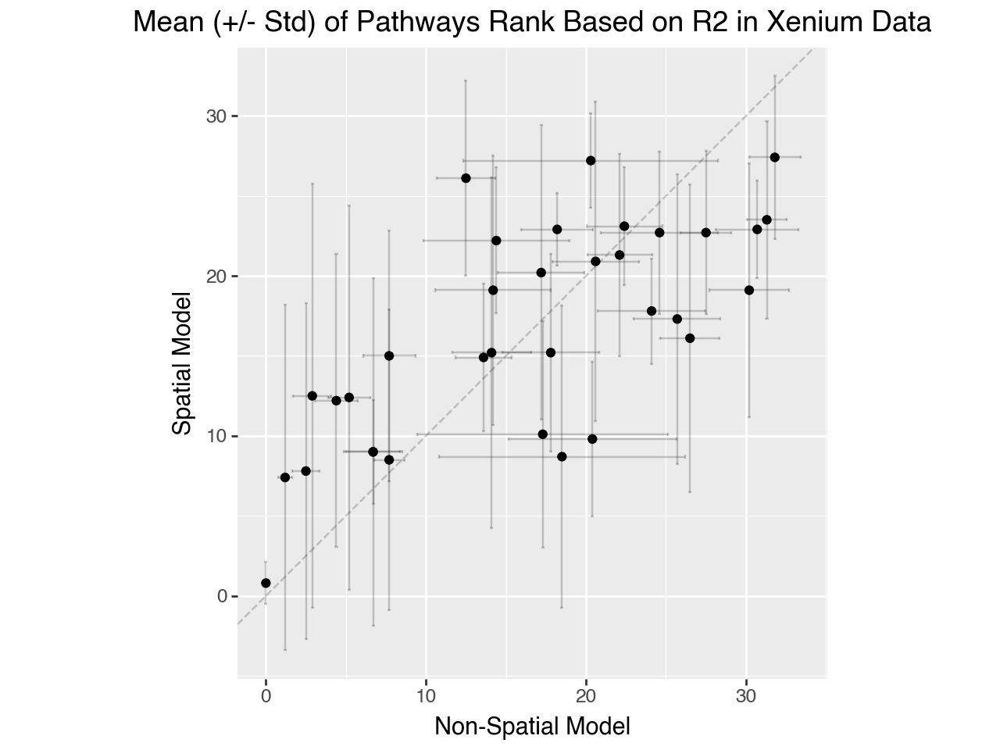

In [9]:
plot = (
    ggplot(df, aes(x="mean_x_ns_rank", y="mean_x_s_rank"))
    + geom_point()
    + geom_errorbar(aes(ymin="mean_x_s_rank - std_x_s_rank", ymax="mean_x_s_rank + std_x_s_rank"), width=0.2, alpha=0.2)
    + geom_errorbarh(aes(xmin="mean_x_ns_rank - std_x_ns_rank", xmax="mean_x_ns_rank + std_x_ns_rank"), height=0.2, alpha=0.2)
    + coord_fixed(ratio=1)
    + labs(title="Mean (+/- Std) of Pathways Rank Based on R2 in Xenium Data", x="Non-Spatial Model", y="Spatial Model")
    + geom_abline(intercept=0, slope=1, linetype="dashed", alpha=0.2)
)
plot.show()

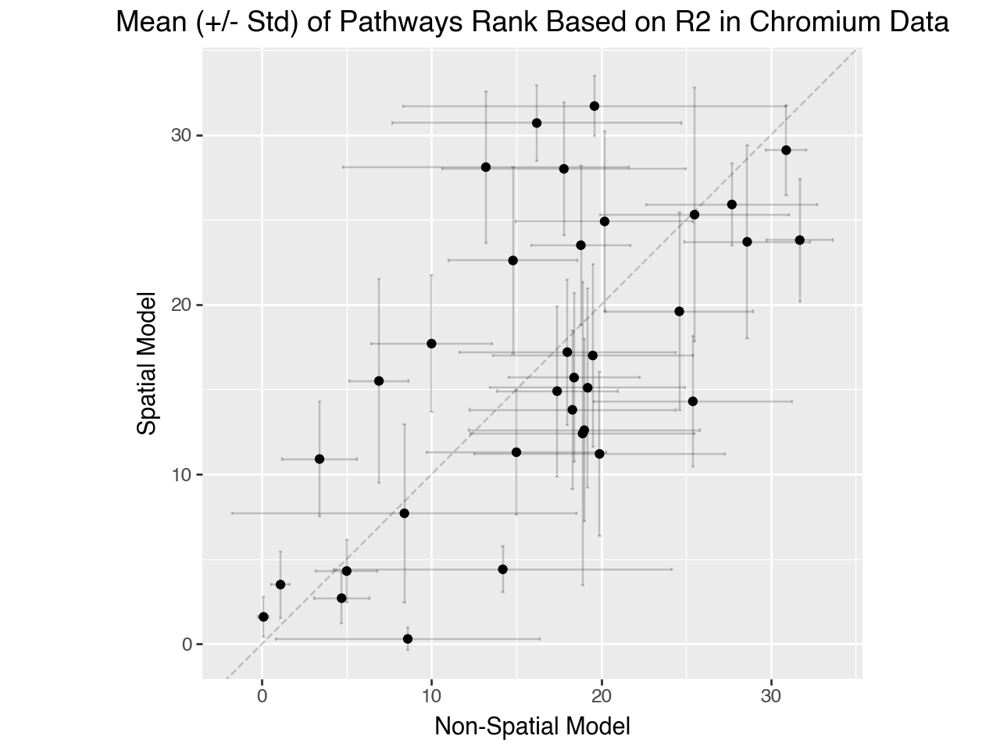

In [7]:
plot = (
    ggplot(df, aes(x="mean_c_ns_rank", y="mean_c_s_rank"))
    + geom_point()
    + geom_errorbar(aes(ymin="mean_c_s_rank - std_c_s_rank", ymax="mean_c_s_rank + std_c_s_rank"), width=0.2, alpha=0.2)
    + geom_errorbarh(aes(xmin="mean_c_ns_rank - std_c_ns_rank", xmax="mean_c_ns_rank + std_c_ns_rank"), height=0.2, alpha=0.2)
    + coord_fixed(ratio=1)
    + labs(title="Mean (+/- Std) of Pathways Rank Based on R2 in Chromium Data", x="Non-Spatial Model", y="Spatial Model")
    + geom_abline(intercept=0, slope=1, linetype="dashed", alpha=0.2)
)
plot.show()

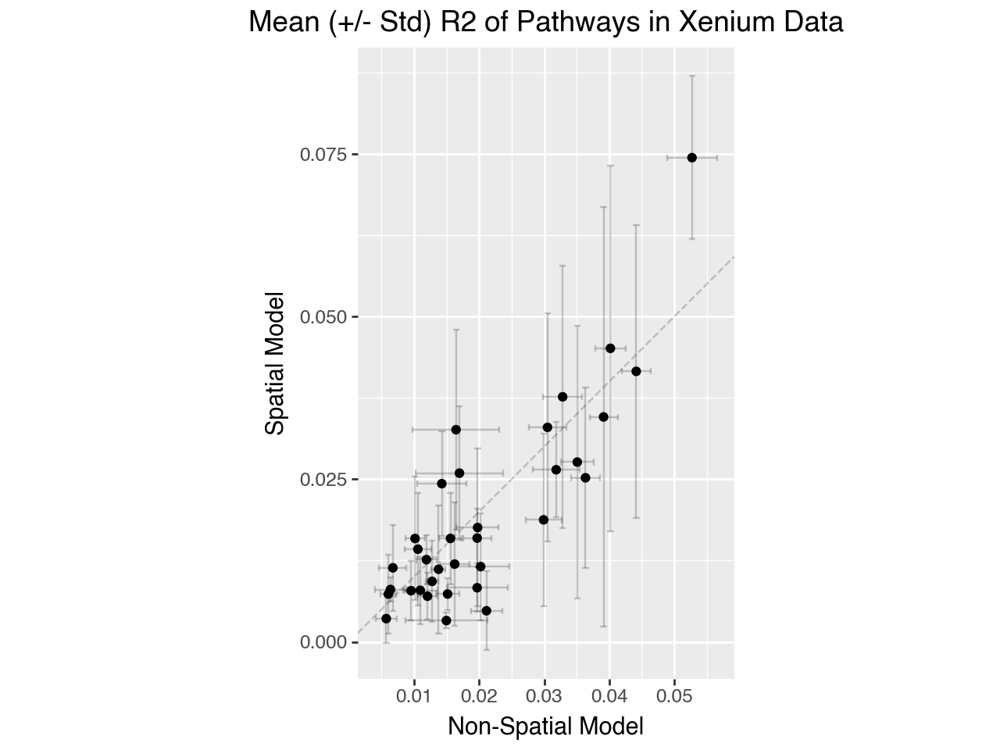

In [11]:
plot = (
    ggplot(df, aes(x="mean_x_ns", y="mean_x_s"))
    + geom_point()
    + geom_errorbar(aes(ymin="mean_x_s - std_x_s", ymax="mean_x_s + std_x_s"), width=0.001, alpha=0.2)
    + geom_errorbarh(aes(xmin="mean_x_ns - std_x_ns", xmax="mean_x_ns + std_x_ns"), height=0.001, alpha=0.2)
    + coord_fixed(ratio=1)
    + labs(title="Mean (+/- Std) R2 of Pathways in Xenium Data", x="Non-Spatial Model", y="Spatial Model")
    + geom_abline(intercept=0, slope=1, linetype="dashed", alpha=0.2)
)
plot.show()

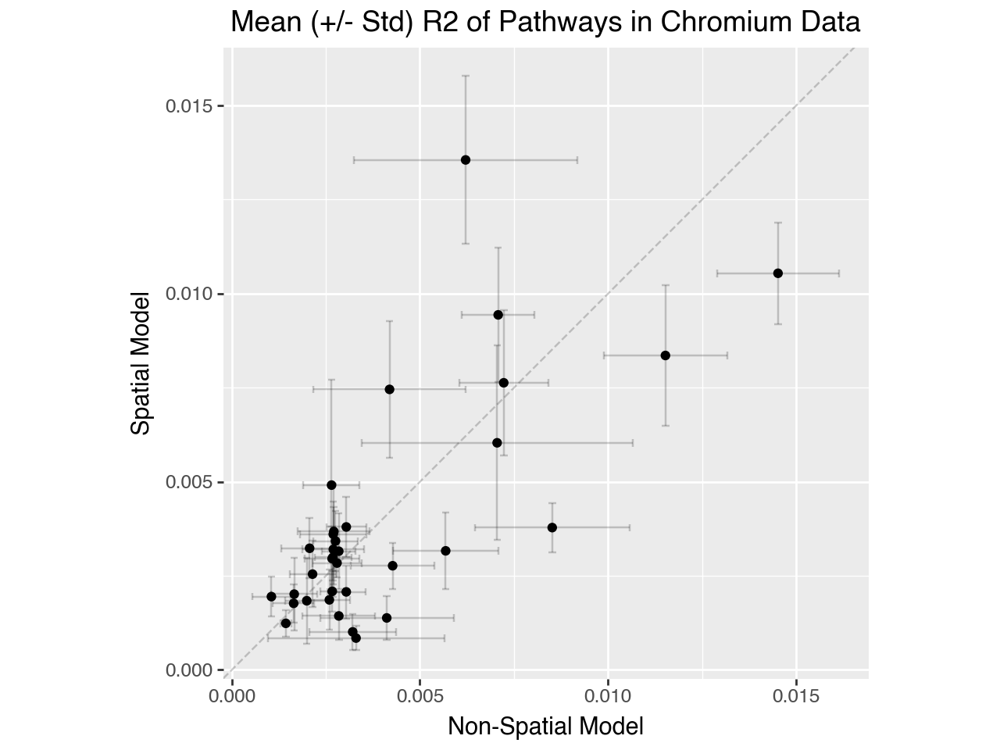

In [15]:
plot = (
    ggplot(df, aes(x="mean_c_ns", y="mean_c_s"))
    + geom_point()
    + geom_errorbar(aes(ymin="mean_c_s - std_c_s", ymax="mean_c_s + std_c_s"), width=0.0002, alpha=0.2)
    + geom_errorbarh(aes(xmin="mean_c_ns - std_c_ns", xmax="mean_c_ns + std_c_ns"), height=0.0002, alpha=0.2)
    + coord_fixed(ratio=1)
    + labs(title="Mean (+/- Std) R2 of Pathways in Chromium Data", x="Non-Spatial Model", y="Spatial Model")
    + geom_abline(intercept=0, slope=1, linetype="dashed", alpha=0.2)
)
plot.show()

In [22]:
z_spatial = models_spatial[0].get_factors()["group_xenium"]
z_non_spatial = models_non_spatial[0].get_factors()["group_xenium"]

### Epithelial Mesenchymal transition

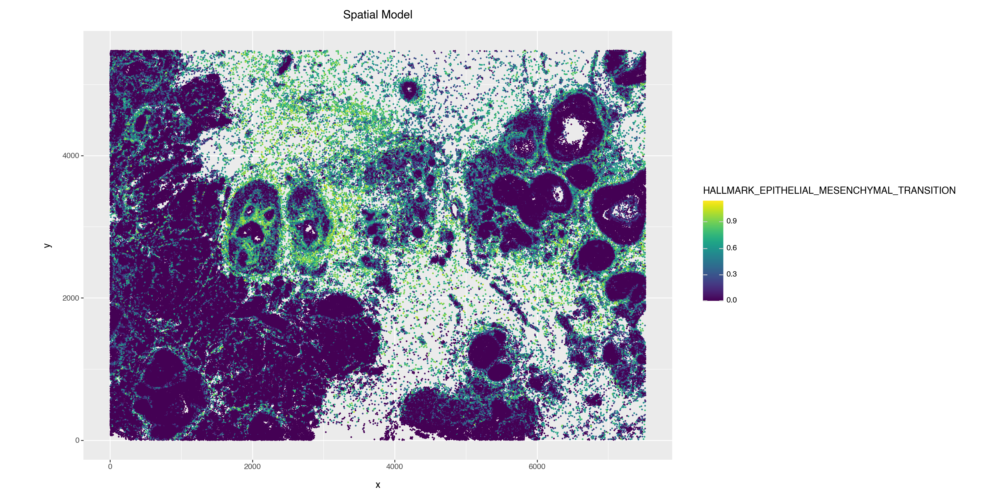

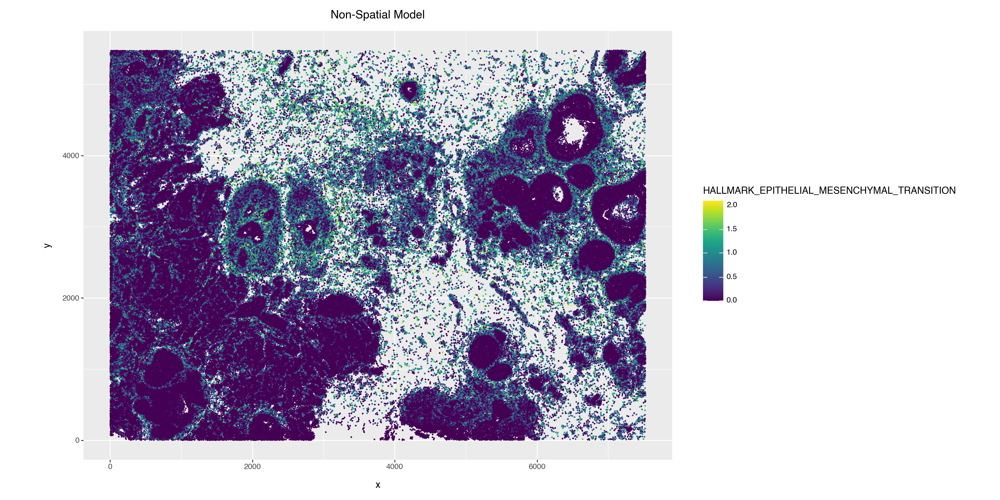

In [41]:
z_spatial["x"] = models_spatial[0].covariates["group_xenium"][:, 0]
z_spatial["y"] = models_spatial[0].covariates["group_xenium"][:, 1]

plot = (
    ggplot(z_spatial, aes(x="x", y="y", color="HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"))
    + geom_point(size=0.1)
    + theme(figure_size=(16, 8))
    + coord_fixed(ratio=1)
    + labs(title="Spatial Model")
)
plot.show()

z_non_spatial["x"] = models_spatial[0].covariates["group_xenium"][:, 0]
z_non_spatial["y"] = models_spatial[0].covariates["group_xenium"][:, 1]

plot = (
    ggplot(z_non_spatial, aes(x="x", y="y", color="HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION"))
    + geom_point(size=0.1)
    + theme(figure_size=(16, 8))
    + coord_fixed()
    + labs(title="Non-Spatial Model")
)
plot.show()

### Estrogen response early

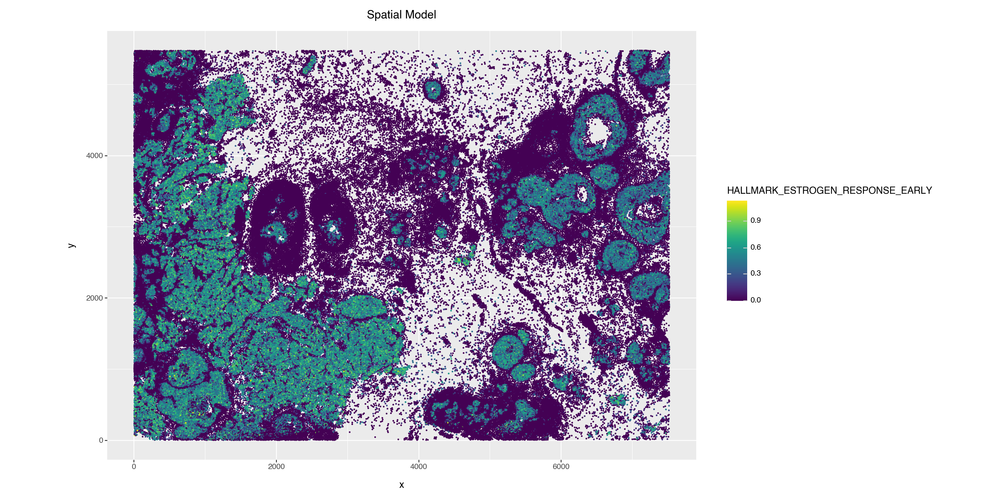

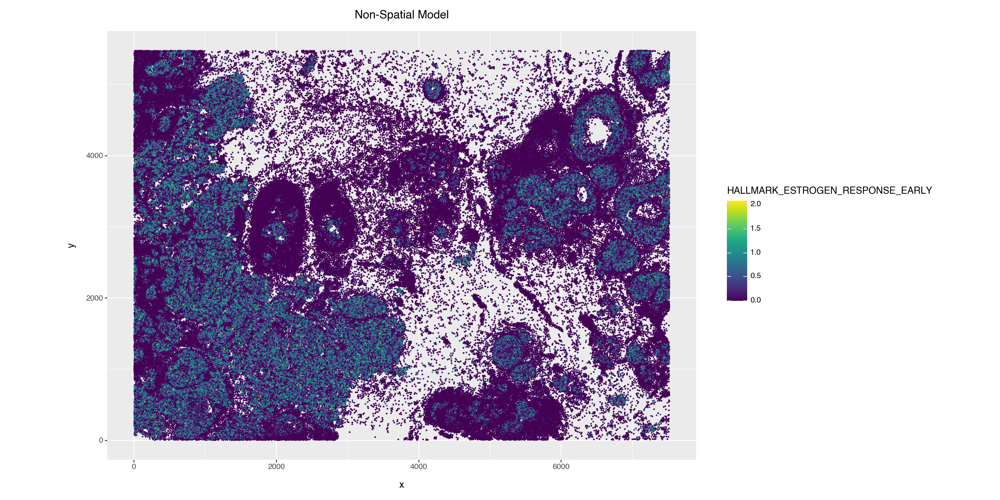

In [42]:
z_spatial["x"] = models_spatial[0].covariates["group_xenium"][:, 0]
z_spatial["y"] = models_spatial[0].covariates["group_xenium"][:, 1]

plot = (
    ggplot(z_spatial, aes(x="x", y="y", color="HALLMARK_ESTROGEN_RESPONSE_EARLY"))
    + geom_point(size=0.1)
    + theme(figure_size=(16, 8))
    + coord_fixed(ratio=1)
    + labs(title="Spatial Model")
)
plot.show()

z_non_spatial["x"] = models_spatial[0].covariates["group_xenium"][:, 0]
z_non_spatial["y"] = models_spatial[0].covariates["group_xenium"][:, 1]

plot = (
    ggplot(z_non_spatial, aes(x="x", y="y", color="HALLMARK_ESTROGEN_RESPONSE_EARLY"))
    + geom_point(size=0.1)
    + theme(figure_size=(16, 8))
    + coord_fixed()
    + labs(title="Non-Spatial Model")
)
plot.show()

### Apical Junction

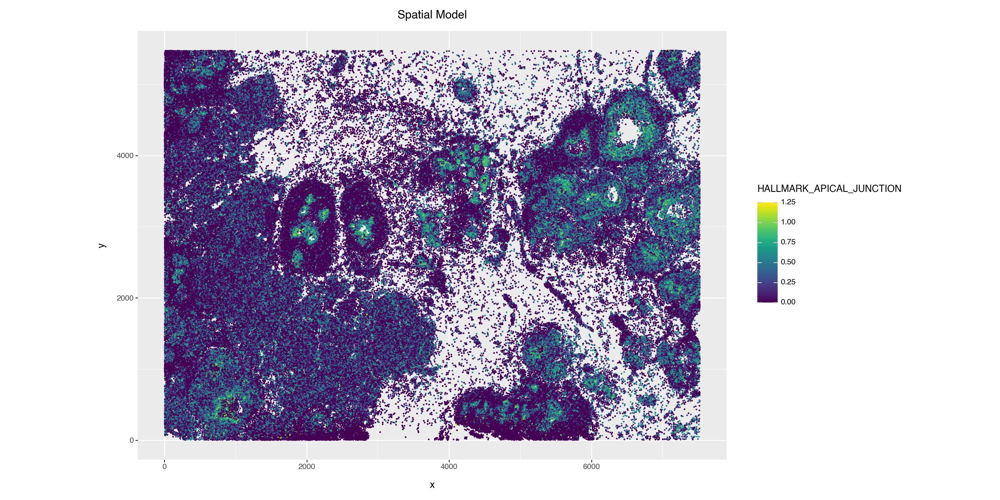

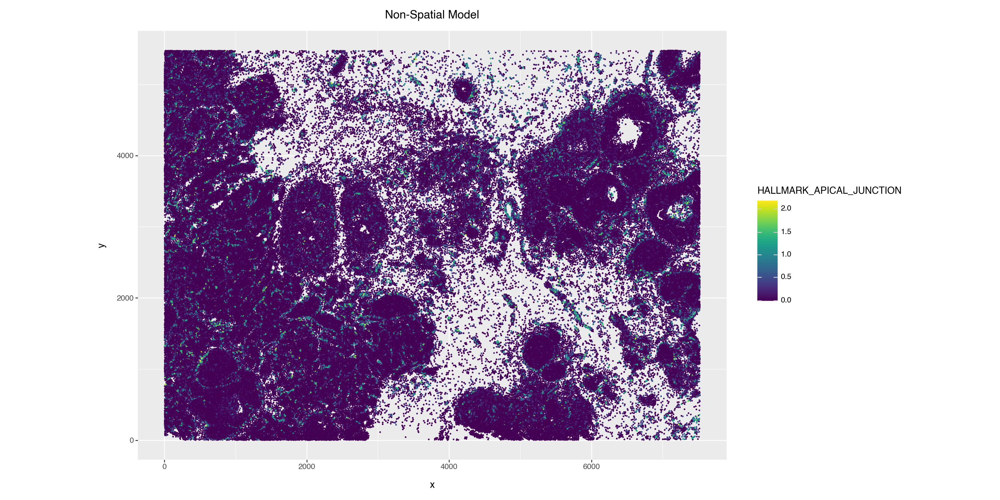

In [43]:
z_spatial["x"] = models_spatial[0].covariates["group_xenium"][:, 0]
z_spatial["y"] = models_spatial[0].covariates["group_xenium"][:, 1]

plot = (
    ggplot(z_spatial, aes(x="x", y="y", color="HALLMARK_APICAL_JUNCTION"))
    + geom_point(size=0.1)
    + theme(figure_size=(16, 8))
    + coord_fixed(ratio=1)
    + labs(title="Spatial Model")
)
plot.show()

z_non_spatial["x"] = models_spatial[0].covariates["group_xenium"][:, 0]
z_non_spatial["y"] = models_spatial[0].covariates["group_xenium"][:, 1]

plot = (
    ggplot(z_non_spatial, aes(x="x", y="y", color="HALLMARK_APICAL_JUNCTION"))
    + geom_point(size=0.1)
    + theme(figure_size=(16, 8))
    + coord_fixed()
    + labs(title="Non-Spatial Model")
)
plot.show()